In [65]:
import sqlite3
import pandas as pd

# function to query db and return a df with lowercase columns, in later steps
def get_df(query):
    connection = sqlite3.connect('database/hotel.db')
    df = pd.read_sql_query(query, connection)
    df.columns = df.columns.str.lower()
    connection.close()
    return df

# get all data from hotel table
connection = sqlite3.connect('database/hotel.db')
hotel_df = pd.read_sql_query('select * from hotel', connection)

# rename dataframe columns to lowercase. Pandas is case sensitive
hotel_df.columns = hotel_df.columns.str.lower()
print(hotel_df.columns)
hotel_df.head()

Index(['id', 'url', 'name', 'address', 'latitude', 'longitude', 'altitude',
       'description', 'rating', 'reviews', 'category_rank', 'star_rating',
       'nearby_restaurants', 'nearby_attractions', 'walkers_score', 'pictures',
       'average_night_price', 'price_range_min', 'price_range_max',
       'property_amenities', 'room_features', 'room_types', 'location_rating',
       'cleanliness_rating', 'service_rating', 'value_rating', 'also_known_as',
       'formerly_known_as', 'city_location', 'number_of_rooms',
       'reviews_summary', 'reviews_keypoint_location',
       'reviews_keypoint_atmosphere', 'reviews_keypoint_rooms',
       'reviews_keypoint_value', 'reviews_keypoint_cleanliness',
       'reviews_keypoint_service', 'reviews_keypoint_amenities',
       'reviews_5_excellent', 'reviews_4_very_good', 'reviews_3_average',
       'reviews_2_poor', 'reviews_1_terrible', 'reviews_keywords',
       'scraped_timestamp', 'insert_update_timestamp'],
      dtype='object')


,id,url,name,address,latitude,longitude,altitude,description,rating,reviews,...,reviews_keypoint_service,reviews_keypoint_amenities,reviews_5_excellent,reviews_4_very_good,reviews_3_average,reviews_2_poor,reviews_1_terrible,reviews_keywords,scraped_timestamp,insert_update_timestamp
0,267437109633874,https://www.tripadvisor.com/Hotel_Review-g1877...,Regia Goito,"Via Goito 17, Rome Italy",41.906067,12.500244,0.0,Looking for a place to stay in Rome? Then look...,1.5,20,...,NA,NA,1,0,3,3,13,NA,2024-03-18 10:58:51,2024-03-18 10:58:51
1,423388210168627,https://www.tripadvisor.com/Hotel_Review-g1877...,B&B Mazza,"Largo Ettore Marchiafava, 3, Rome Italy",41.907373,12.517269,0.0,NA,4.0,5,...,NA,NA,1,4,0,0,0,NA,2024-03-18 11:41:46,2024-03-18 11:41:46
2,454371077005232,https://www.tripadvisor.com/Hotel_Review-g1877...,B&B Casasuri,"Via Enrico Cialdini 13, 00185 Rome Italy",41.898488,12.503187,0.0,B&B Casasuri is an excellent choice for travel...,4.0,2,...,NA,NA,1,0,1,0,0,NA,2024-03-18 15:03:54,2024-03-18 15:03:54
3,492462491596955,https://www.tripadvisor.com/Hotel_Review-g1877...,Villa Faby B&B,"Via Leonida Lay, 195 Trigoria, Rome Italy",41.755265,12.472212,0.0,See why so many travelers make Villa Faby B&B ...,5.0,1,...,NA,NA,1,0,0,0,0,NA,2024-03-18 11:52:08,2024-03-18 11:52:08
4,842369030272705,https://www.tripadvisor.com/Hotel_Review-g1877...,President Gardens,"Via Rasella 148, 00187 Rome Italy",41.902439,12.487371,0.0,NA,4.0,6,...,NA,NA,4,0,0,1,1,NA,2024-03-18 12:51:50,2024-03-18 12:51:50


In [151]:
import folium

def get_gridmap(query, color_attribute, num_rows=50, num_cols=50, zoom_start=12, font_size=8, weight=1, colors=None, index=None, center=True):
    """ num_rows, num_cols: number of rows and columns for the grid. If not provided, default to 50 """

    # Get the data points from the database, using the provided query
    df = get_df(query)
    print('Query output:')
    print(df.head())

    # Calculate the size of each grid cell
    lat_range = df['latitude'].max() - df['latitude'].min()
    lon_range = df['longitude'].max() - df['longitude'].min()
    lat_step = lat_range / num_rows
    lon_step = lon_range / num_cols

    # Create a folium map centered at the mean latitude and longitude of the data points with an initial zoom level of 2
    m = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=zoom_start, tiles='cartodbpositron')

    if colors is None and index is None:
        # Define a colormap for the ratings with more colors using a linear colormap. Steps are customized to highlight the differences in ratings.
        colors = ['#FF6666', '#FFB366', '#FFFF66', '#339933', '#1b85b8']
        colormap = folium.LinearColormap(colors=colors, vmin=1, vmax=5, index=[1, 3, 3.5, 4, 4.5], caption=color_attribute)
    else:
        colormap = folium.LinearColormap(colors=colors, vmin=df[color_attribute].min(), vmax=df[color_attribute].max(), index=index, caption=color_attribute)

    # Iterate over each grid cell
    for i in range(num_rows):
        for j in range(num_cols):
            # Calculate the boundaries of the current grid cell
            lat_min = df['latitude'].min() + i * lat_step
            lat_max = df['latitude'].min() + (i + 1) * lat_step
            lon_min = df['longitude'].min() + j * lon_step
            lon_max = df['longitude'].min() + (j + 1) * lon_step
            
            # Filter hotels within the current grid cell
            hotels_in_cell = df[(df['latitude'] >= lat_min) & (df['latitude'] < lat_max) & (df['longitude'] >= lon_min) & (df['longitude'] < lon_max)]
            
            # Calculate the average rating for the current grid cell
            avg_rating = hotels_in_cell[color_attribute].mean()

            # Color the grid cell based on the average rating
            if len(hotels_in_cell) == 0:
                color = 'rgba(0, 0, 0, 0)'  # Transparent color for empty cells
            else:
                color = colormap(avg_rating)
                    
            # Create a rectangle representing the grid cell and add it to the map
            folium.Rectangle(bounds=[[lat_min, lon_min], [lat_max, lon_max]], color=color, fill=True, fill_opacity=0.5, weight=weight).add_to(m)

            # Add text label about the number of hotels
            if len(hotels_in_cell) > 0:
                folium.map.Marker([(lat_min + lat_max) / 2, (lon_min + lon_max) / 2],
                                icon=folium.DivIcon(html=f'<div style="font-size: {font_size}pt; color: black; font=Roboto">{len(hotels_in_cell)}</div>')).add_to(m)
    

    # add white background to the colormap (legend) on the top right of the map
    svg_style = '<style>svg#legend {background-color: white; border-radius: 10px;}</style>'
    m.get_root().header.add_child(folium.Element(svg_style))

    colormap.add_to(m)

    # Add text label for color attribute
    folium.map.Marker([df['latitude'].max()+0.003, df['longitude'].min()+0.005],  # Adjust position for top left corner
                      icon=folium.DivIcon(html=f'<div style="font-size: {font_size+10}pt; color: white; font=Roboto">{color_attribute}</div>')).add_to(m)

    gra_coordinates = [
        (41.95599312856956, 12.38429590176482), # top left (Ottavia)
        (41.97024610942314, 12.40746422272264),
        (41.971300436721165, 12.414328047668834),
        (41.978591325554895, 12.428287220114637),
        (41.980874264564086, 12.435909047874086),
        (41.98221250308595, 12.44456142839791), # via veientana
        (41.98153161821228, 12.457721660413913), # via di quarto annunziata
        (41.98607444445743, 12.47493946122003), # via veientana nuova
        (41.9860864505197, 12.494350776611357), # via flaminia 
        (41.99074229228052, 12.50224196917452),
        (41.99074614137014, 12.508650705708398),
        (41.957643421734375, 12.580933443817395), # via nomentana
        (41.915104656365614, 12.615568334900995),
        (41.88921668477889, 12.614684040154145), # via tor bella monaca
        (41.863537740551074, 12.600535318396178),
        (41.845941968684286, 12.594647129960238),
        (41.81310099509219, 12.573451232793662), # via appia nuova
        (41.800896239533174, 12.550124531069153), 
        (41.795378258246174, 12.52584457469644), 
        (41.79424952171819, 12.510256057765057), # via della cecchignola
        (41.8031534585853, 12.435790048772901), # via cristoforo colombo
        (41.80754226799676, 12.419977236517546), # via ostiense
        (41.81330996023854, 12.395697280393534),
        (41.866949679156555, 12.373996718926886),
        (41.882440009925894, 12.380837722857946), # via aurelia
        (41.896549226237006, 12.38156668227417),
        (41.91231072964025, 12.385434864274632), # via di boccea
        (41.922348339863476, 12.381834645926402),
        (41.932587787973276, 12.38074090872054),
        (41.95599312856956, 12.38429590176482),

    ]
    folium.PolyLine(locations=gra_coordinates, color='#9245e3', tooltip='Grande Raccordo Anulare (A90)', opacity=0.5, weight=10).add_to(m)


    # # point of interest for tourists
    # points_of_interest = [
    #     [41.890209, 12.492231], # colosseum
    #     [41.902168, 12.453937], # vatican
    #     [41.900932, 12.483313], # trevi fountain
    #     [41.898609, 12.476873], # pantehon
    #     [41.905991, 12.482775], # spanish steps
    #     [41.896435, 12.482531], # piazza venezia
    #     [41.899139, 12.473311], # navona square
    #     # [41.900833, 12.501944], # termini station
    #     [41.911015, 12.476190], # piazza del popolo
    # ]
    # for poi in points_of_interest:
    #     folium.CircleMarker(
    #         location=poi,
    #         radius=8,  # Adjust the radius as needed
    #         color='#9245e3',  # Outline color
    #         fill=True,
    #         opacity=0.7,
    #         fill_color='#9245e3',  # Fill color
    #         fill_opacity=0.7,
    #     ).add_to(m)

    if center == True:
        points_of_interest_dict = {
            'Colosseum': [41.890209, 12.492231],
            'St. Peter': [41.902168, 12.453937],
            'Trevi Fountain': [41.900932, 12.483313],
            'Pantheon': [41.898609, 12.476873],
            'Spanish Steps': [41.905991, 12.482775],
            'Piazza Venezia': [41.896435, 12.482531],
            'Piazza Navona': [41.899139, 12.473311],
            'Termini Station': [41.900833, 12.501944],
            'Piazza del Popolo': [41.911015, 12.476190],
        }
        for poi_name, poi in points_of_interest_dict.items():
            folium.CircleMarker(
                location=poi,
                radius=5,  # Adjust the radius as needed
                color='#9245e3',  # Outline color
                fill=True,
                opacity=0.7,
                fill_color='#9245e3',  # Fill color
                fill_opacity=0.7,
            ).add_to(m)
            # text to display on the marker
            html = f"""
                <div style="
                    font-size: 9pt; 
                    color: rgba(146,69,227, 0.7);
                    white-space: nowrap;
                    ">
                    {poi_name}
                </div>
            """
            # Add the text as a marker with a custom icon
            folium.Marker(
                location=[poi[0]+0.001, poi[1]],
                icon=folium.DivIcon(html=html)
            ).add_to(m)

        # rectangle of the center of rome
        top_left = [41.92184507325442, 12.44003904689945]
        bottom_right = [41.88071168277779, 12.523923092575103]
        # Add the rectangle to the map
        folium.Rectangle(
            bounds=[top_left, bottom_right],
            color='#9245e3',
            weight=10,
            fill=False,
            opacity=0.5,
            # fill_opacity=0.5,
            tooltip='Rectangle Area'
        ).add_to(m)







    return m


def screenshot_resize(screenshot_path):
    from PIL import Image as PILImage
    image = PILImage.open(screenshot_path)
    # Get the current dimensions of the image
    width, height = image.size
    # Calculate the new dimensions (half the original dimensions)
    new_width = int(width * 0.5)
    new_height = int(height * 0.5)
    # Resize the image to the new dimensions
    resized_image = image.resize((new_width, new_height))
    # Save the resized image with a new filename
    resized_image.save(screenshot_path)
    # Close the images
    image.close()
    resized_image.close()
    return
    # to do: save the original image in a folder and the resized image in another folder

import os
import time
from selenium import webdriver
from IPython.display import Image


def save_map_img(map, map_name, browser_zoom=None):
    """ Save the map as an HTML file, open it in a WebDriver, take a screenshot, and display it in the notebook """
    # Save the map as an HTML file
    map_html = f'maps/{map_name}.html'
    map.save(map_html)
    # Open the HTML file in the WebDriver
    driver = webdriver.Chrome()
    if browser_zoom:
        driver.get('chrome://settings/')
        driver.execute_script(f'chrome.settingsPrivate.setDefaultZoom({browser_zoom});')
    driver.get('file:///' + os.path.abspath(map_html))
    time.sleep(2)
    # Take a screenshot of the map
    screenshot_path = f'maps/{map_name}.png'
    driver.save_screenshot(screenshot_path)
    driver.quit()
    screenshot_resize(screenshot_path)
    return

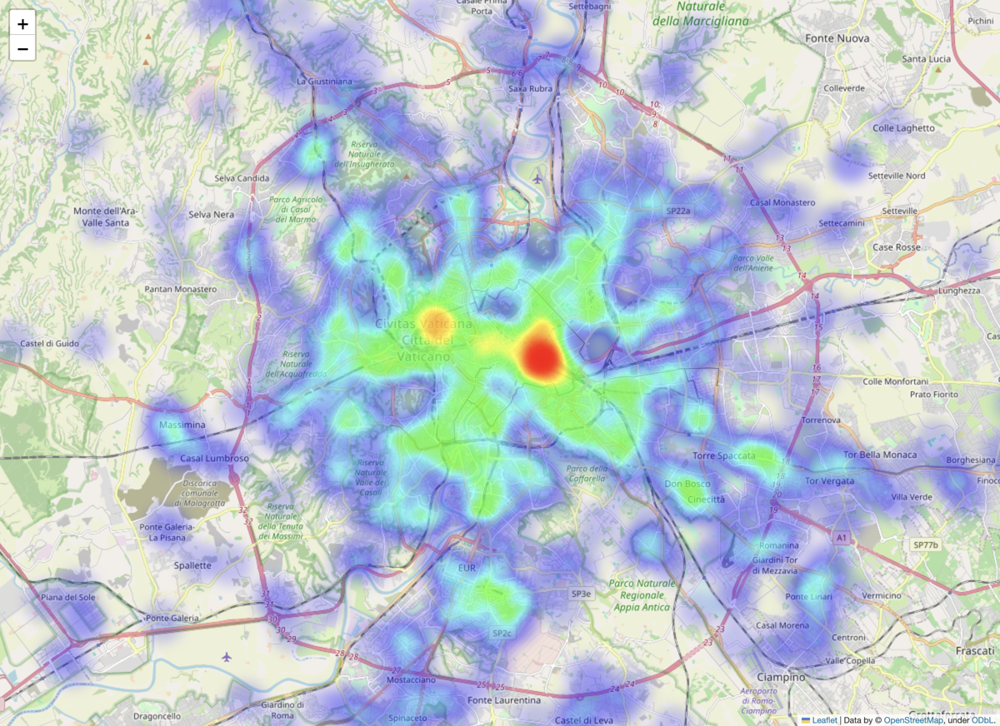

In [71]:
import folium
from folium.plugins import HeatMap
import pandas as pd

# Assuming get_df is a function that runs the query and returns a DataFrame
query = """select mp.LATITUDE, mp.LONGITUDE from HOTEL h left join hotel_mapquest_location mp on h.ID = mp.HOTEL_ID where mp.RANK = 0 and ADMIN_AREA_4 = 'Rome' and mp.LATITUDE is not null"""
df = get_df(query)
df.head()

# Create a folium map centered at the mean latitude and longitude of the data points with an initial zoom level of 12
m = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=12)

# Construct the heatmap data with only latitude and longitude
heat_data = [[row['latitude'], row['longitude']] for index, row in df.iterrows()]

# Add the heatmap layer to the folium map
HeatMap(heat_data, min_opacity=0.2).add_to(m)

# Display the folium map
m

map_name = 'heatmap_rome'
save_map_img(map=m, map_name=map_name)
Image(filename=f'maps/{map_name}.png')

/var/folders/0g/w_2j2dtn49l6qtdk1r46zqtc0000gn/T/ipykernel_35679/2848691710.py:15: UserWarning: The `max_val` parameter is no longer necessary. The largest intensity is calculated automatically.
  HeatMap(heat_data, min_opacity=0.2, max_val=max(df['rating'])).add_to(m)


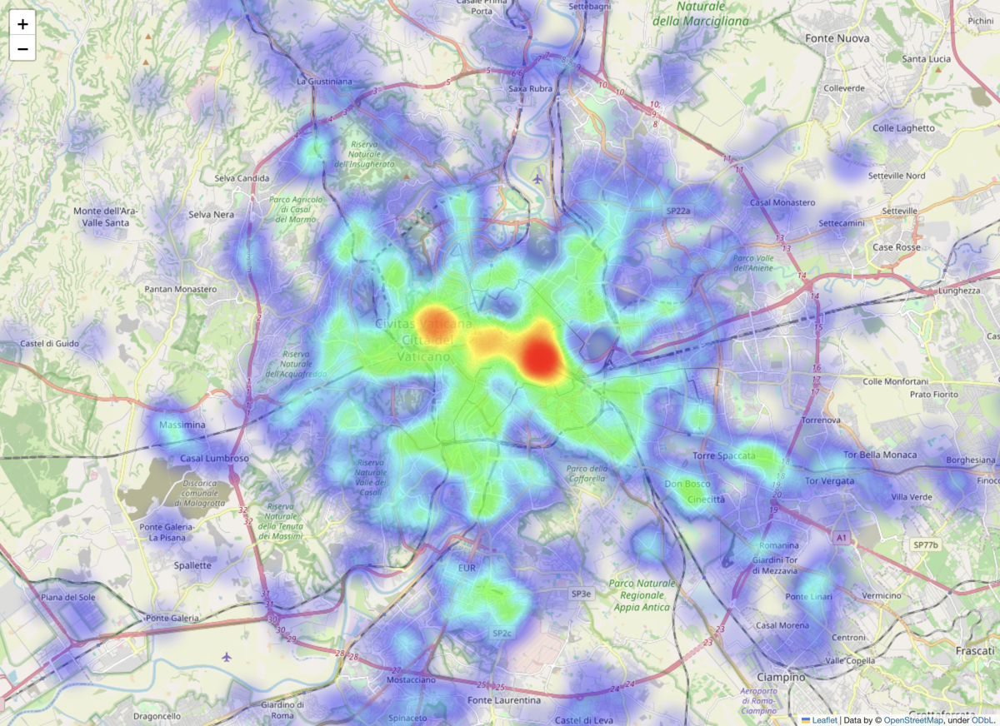

In [69]:
import folium
from folium.plugins import HeatMap

query = """select mp.LATITUDE, mp.LONGITUDE, h.RATING from HOTEL h left join hotel_mapquest_location mp on h.ID = mp.HOTEL_ID where mp.RANK = 0 and ADMIN_AREA_4 = 'Rome' and mp.LATITUDE is not null"""
df = get_df(query)
df.head()

# Create a folium map centered at the mean latitude and longitude of the data points with an initial zoom level of 2
m = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=12)

# Construct the heatmap data with latitude, longitude, and rating
heat_data = [[row['latitude'], row['longitude'], row['rating']] for index, row in df.iterrows()]

# Add the heatmap layer to the folium map, using the 'rating' column as weights
HeatMap(heat_data, min_opacity=0.2, max_val=max(df['rating'])).add_to(m)

# Display the folium map
m

map_name = 'heatmap_rome'
save_map_img(map=m, map_name=map_name)
Image(filename=f'maps/{map_name}.png')

Query output:
                   id  latitude  longitude  rating
0  593410961110347089  41.90153   12.50542     1.5
1  571677155464358671  41.90719   12.48922     4.0
2  935235166427068328  41.89297   12.47890     5.0
3  273620037308605479  41.89738   12.42172     2.5
4  930799119798315260  41.89385   12.49011     4.0


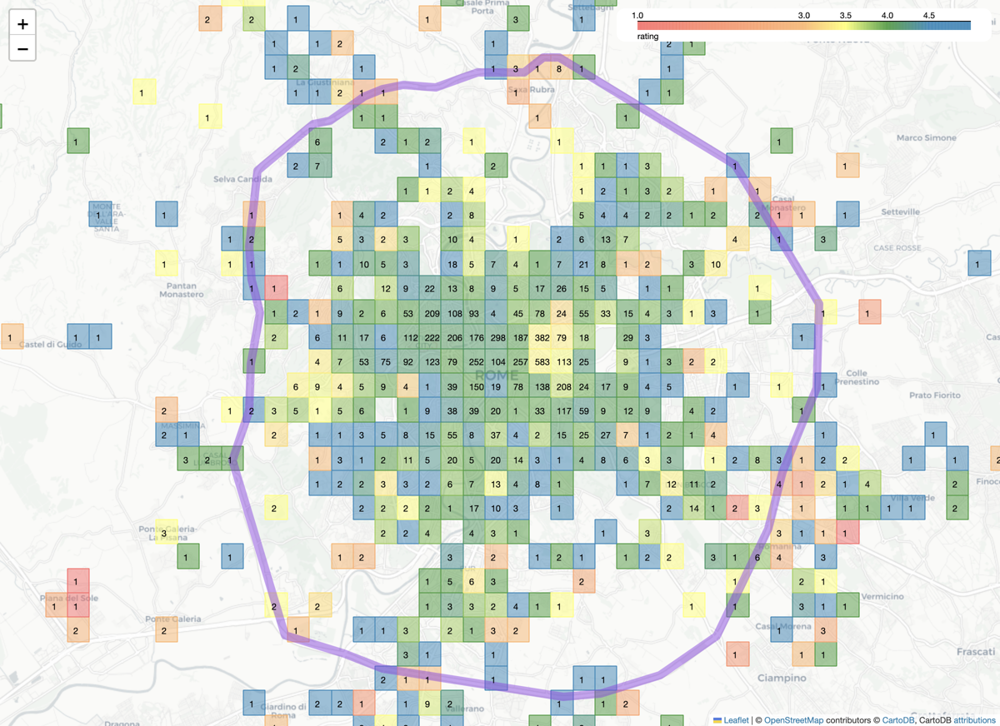

In [152]:
query = """
    select 
        h.id,
        mp.latitude, 
        mp.longitude, 
        h.rating 
    from 
        hotel h 
        left join hotel_mapquest_location mp on h.id = mp.hotel_id 
    where 
        -- Geocode conditions
        mp.rank = 0 -- Keep only the main location of the hotel
        and admin_area_4 = 'Rome' -- Remove few wrong geocoded hotels
        and mp.latitude is not null -- Remove non geocoded hotels (non reviewed hotels)
        and admin_area_5 = 'Rome' -- Restrict to hotels in Rome    
"""
color_attribute = 'rating'
m = get_gridmap(query=query, color_attribute=color_attribute, center=False)

map_name = 'gridmap_rome'
save_map_img(map=m, map_name=map_name)
Image(filename=f'maps/{map_name}.png')

Query output:
                   id  latitude  longitude  avg_price
0  593410961110347089  41.90153   12.50542         50
1  571677155464358671  41.90719   12.48922         87
2  935235166427068328  41.89297   12.47890          0
3  273620037308605479  41.89738   12.42172         15
4  930799119798315260  41.89385   12.49011        101


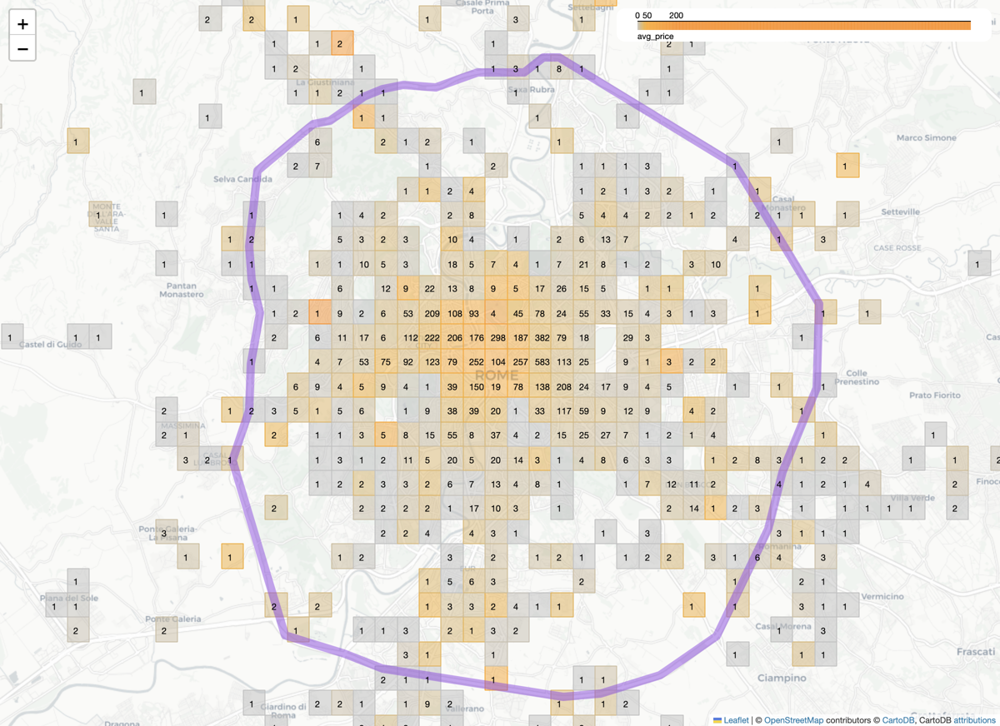

In [155]:
"""
Center of Rome boundaries:
top left = 41.92184507325442, 12.44003904689945
bottom right = 41.88071168277779, 12.523923092575103
"""

query = """
    select 
        h.id,
        mp.latitude, 
        mp.longitude, 
        (h.price_range_max - h.price_range_min) / 2 as avg_price
    from 
        hotel h 
        left join hotel_mapquest_location mp on h.id = mp.hotel_id 
    where 
        -- Geocode conditions
        mp.rank = 0 -- Keep only the main location of the hotel
        and admin_area_4 = 'Rome' -- Remove few wrong geocoded hotels
        and mp.latitude is not null -- Remove non geocoded hotels (non reviewed hotels)
        and admin_area_5 = 'Rome' -- Restrict to hotels in Rome
    """
color_attribute = 'avg_price'
m = get_gridmap(query=query, color_attribute=color_attribute, colors=['silver','orange','darkorange'], index=[0, 50, 200], center=False)

map_name = 'gridmap_rome_avg_price'
save_map_img(map=m, map_name=map_name, browser_zoom=None)
Image(filename=f'maps/{map_name}.png')

Query output:
                   id  latitude  longitude  rating
0  593410961110347089  41.90153   12.50542     1.5
1  571677155464358671  41.90719   12.48922     4.0
2  935235166427068328  41.89297   12.47890     5.0
3  930799119798315260  41.89385   12.49011     4.0
4  352840887461506464  41.90700   12.47790     3.5


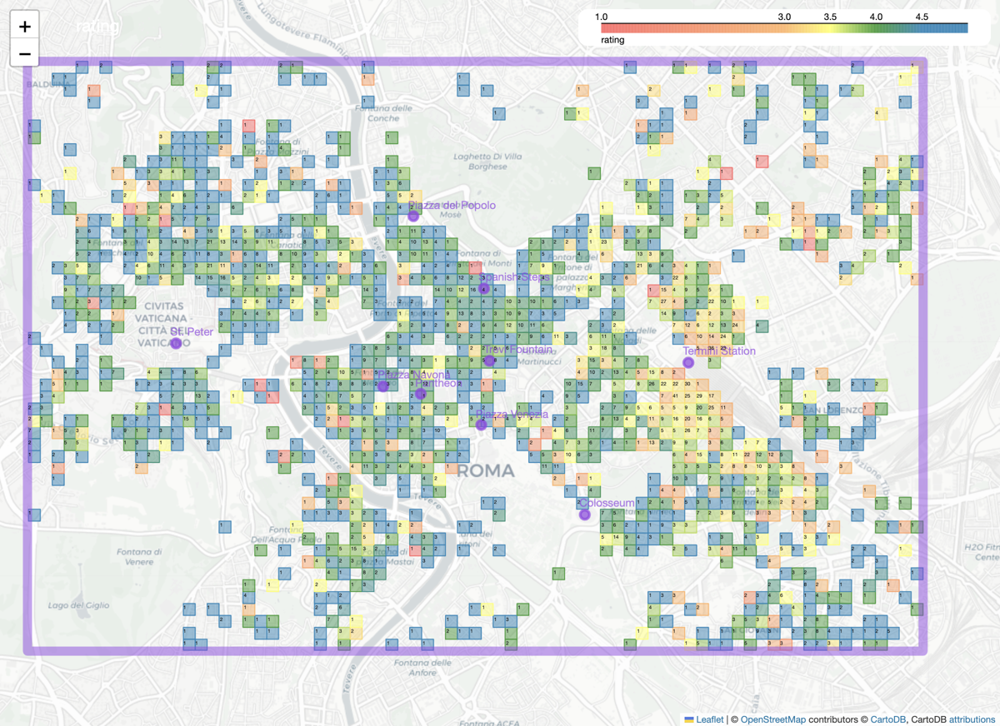

In [156]:
"""
Center of Rome boundaries:
top left = 41.92184507325442, 12.44003904689945
bottom right = 41.88071168277779, 12.523923092575103
"""

query = """
    select 
        h.id,
        mp.latitude, 
        mp.longitude, 
        h.rating 
    from 
        hotel h 
        left join hotel_mapquest_location mp on h.id = mp.hotel_id 
    where 
        -- Geocode conditions
        mp.rank = 0 -- Keep only the main location of the hotel
        and admin_area_4 = 'Rome' -- Remove few wrong geocoded hotels
        and mp.latitude is not null -- Remove non geocoded hotels (non reviewed hotels)
        and admin_area_5 = 'Rome' -- Restrict to hotels in Rome
        -- Center of Rome boundaries
        and mp.latitude <= 41.92184507325442 and mp.latitude >= 41.88071168277779 and mp.longitude <= 12.523923092575103 and mp.longitude >= 12.44003904689945
    """
color_attribute = 'rating'
m = get_gridmap(query=query, color_attribute=color_attribute, num_rows=50, num_cols=75, zoom_start=14, font_size=4)

map_name = 'gridmap_rome_center'
save_map_img(map=m, map_name=map_name, browser_zoom=1.1)
Image(filename=f'maps/{map_name}.png')

Query output:
                id  latitude  longitude  reviews
0  267437109633874  41.90613   12.50030       20
1  423388210168627  41.90736   12.51720        5
2  454371077005232  41.89850   12.50327        2
3  842369030272705  41.90250   12.48775        6
4  925891832265330  41.89003   12.49456        1


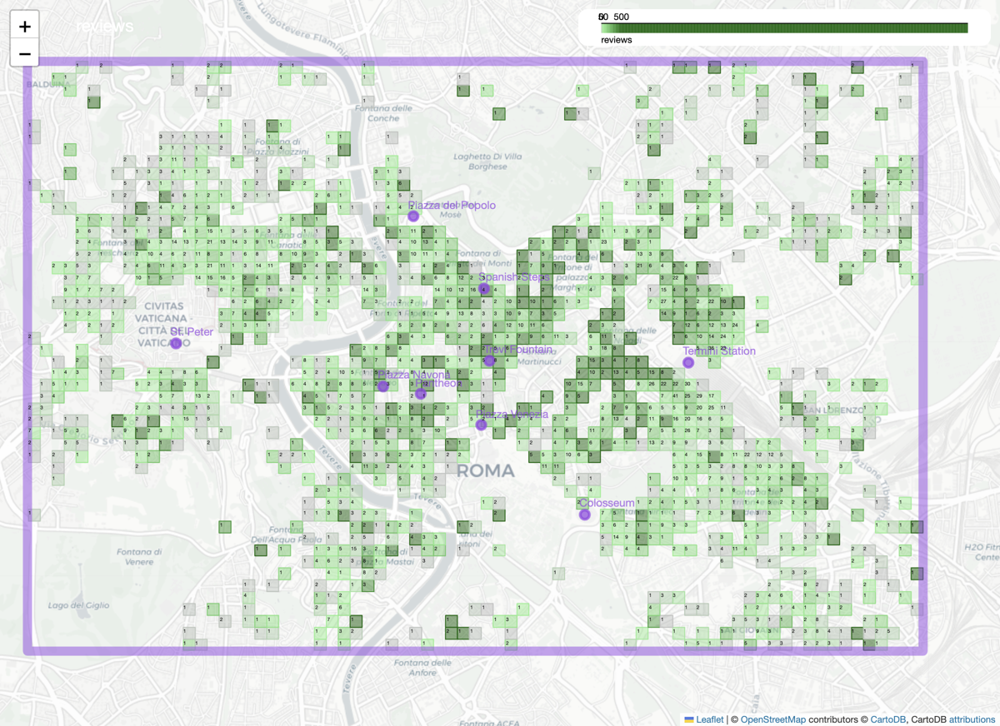

In [157]:
"""
Center of Rome boundaries:
top left = 41.92184507325442, 12.44003904689945
bottom right = 41.88071168277779, 12.523923092575103
"""

query = """
    select 
        h.id,
        mp.latitude, 
        mp.longitude, 
        count(r.id) as reviews
    from 
        hotel h 
        left join hotel_mapquest_location mp on h.id = mp.hotel_id 
        left join review r on h.id = r.hotel_id
    where 
        -- Geocode conditions
        mp.rank = 0 -- Keep only the main location of the hotel
        and admin_area_4 = 'Rome' -- Remove few wrong geocoded hotels
        and mp.latitude is not null -- Remove non geocoded hotels (non reviewed hotels)
        and admin_area_5 = 'Rome' -- Restrict to hotels in Rome
        -- Center of Rome boundaries
        and mp.latitude <= 41.92184507325442 and mp.latitude >= 41.88071168277779 and mp.longitude <= 12.523923092575103 and mp.longitude >= 12.44003904689945
    group by 1,2,3
    """
color_attribute = 'reviews'
m = get_gridmap(query=query, color_attribute=color_attribute, num_rows=50, num_cols=75, zoom_start=14, font_size=4, colors=['silver','lightgreen','darkgreen'], index=[0, 50, 500])

map_name = 'gridmap_rome_center_reviews'
save_map_img(map=m, map_name=map_name, browser_zoom=1.1)
Image(filename=f'maps/{map_name}.png')

Query output:
                   id  latitude  longitude  avg_price
0  593410961110347089  41.90153   12.50542         50
1  571677155464358671  41.90719   12.48922         87
2  935235166427068328  41.89297   12.47890          0
3  930799119798315260  41.89385   12.49011        101
4  352840887461506464  41.90700   12.47790          0


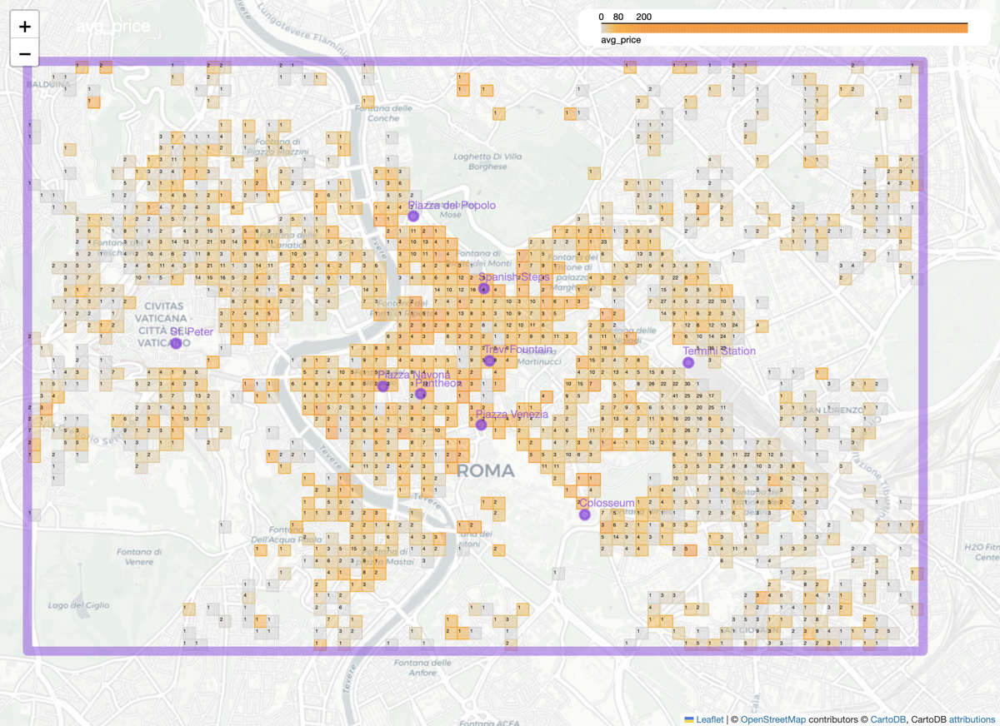

In [158]:
"""
Center of Rome boundaries:
top left = 41.92184507325442, 12.44003904689945
bottom right = 41.88071168277779, 12.523923092575103
"""

query = """
    select 
        h.id,
        mp.latitude, 
        mp.longitude, 
        (h.price_range_max - h.price_range_min) / 2 as avg_price
    from 
        hotel h 
        left join hotel_mapquest_location mp on h.id = mp.hotel_id 
    where 
        -- Geocode conditions
        mp.rank = 0 -- Keep only the main location of the hotel
        and admin_area_4 = 'Rome' -- Remove few wrong geocoded hotels
        and mp.latitude is not null -- Remove non geocoded hotels (non reviewed hotels)
        and admin_area_5 = 'Rome' -- Restrict to hotels in Rome
        -- Center of Rome boundaries
        and mp.latitude <= 41.92184507325442 and mp.latitude >= 41.88071168277779 and mp.longitude <= 12.523923092575103 and mp.longitude >= 12.44003904689945
    """
color_attribute = 'avg_price'
m = get_gridmap(query=query, color_attribute=color_attribute, num_rows=50, num_cols=75, zoom_start=14, font_size=4, colors=['lightgray','orange','darkorange'], index=[0, 80, 200])


map_name = 'gridmap_rome_center_avg_price'
save_map_img(map=m, map_name=map_name, browser_zoom=1.1)
Image(filename=f'maps/{map_name}.png')

Query output:
                   id  latitude  longitude  location_rating
0  593410961110347089  41.90153   12.50542              2.0
1  571677155464358671  41.90719   12.48922              4.6
2  930799119798315260  41.89385   12.49011              4.9
3  352840887461506464  41.90700   12.47790              5.0
4  855279181689269109  41.90904   12.44484              4.4
Query output:
                   id  latitude  longitude  service_rating
0  593410961110347089  41.90153   12.50542             1.0
1  571677155464358671  41.90719   12.48922             4.3
2  930799119798315260  41.89385   12.49011             4.2
3  352840887461506464  41.90700   12.47790             3.8
4  855279181689269109  41.90904   12.44484             4.4
Query output:
                   id  latitude  longitude  cleanliness_rating
0  571677155464358671  41.90719   12.48922                 4.4
1  930799119798315260  41.89385   12.49011                 4.6
2  352840887461506464  41.90700   12.47790             

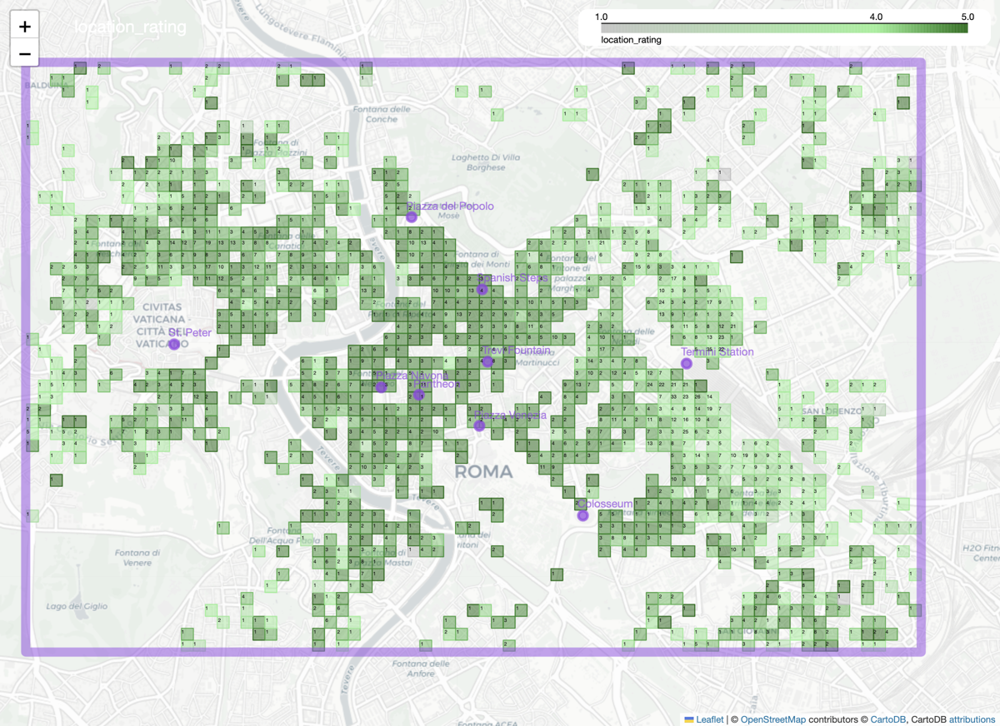

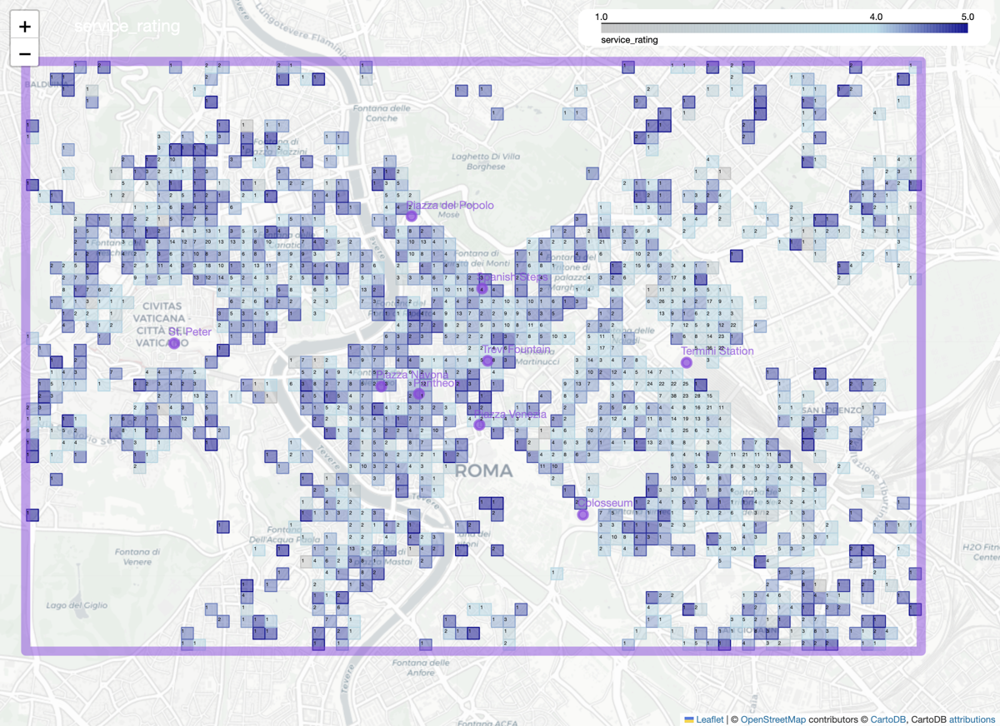

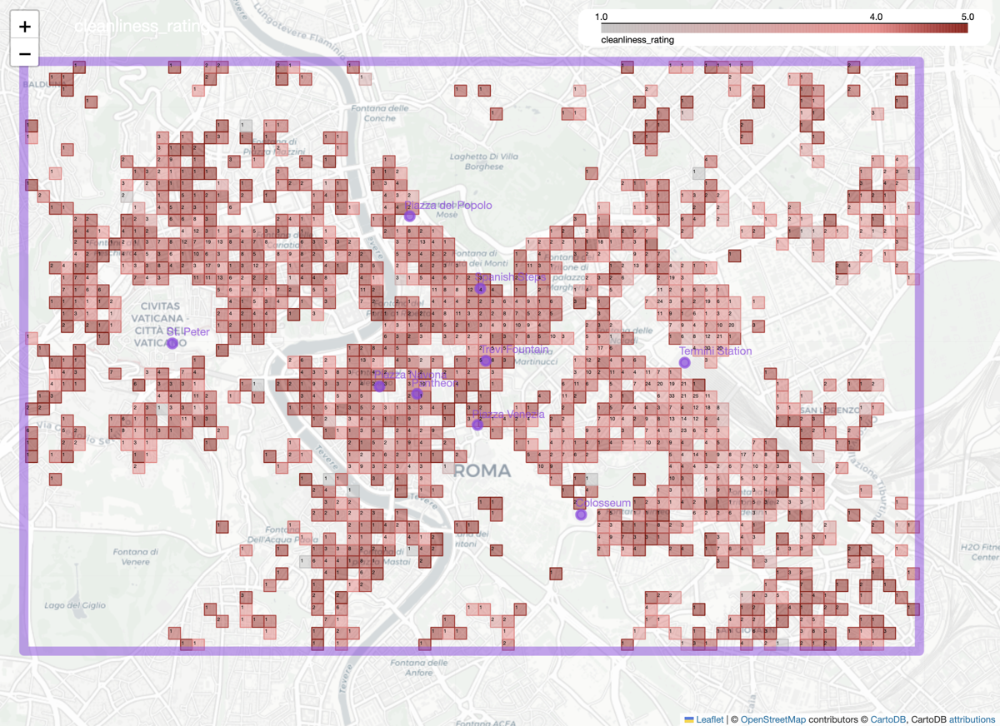

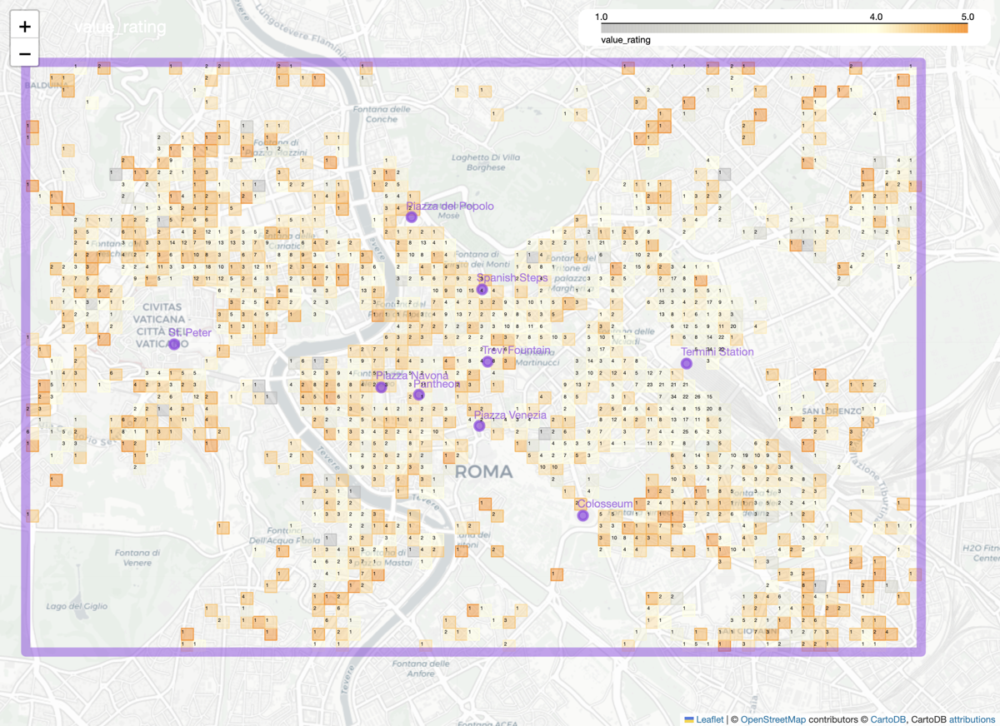

In [162]:

"""
Center of Rome boundaries:
top left = 41.92184507325442, 12.44003904689945
bottom right = 41.88071168277779, 12.523923092575103
"""

rating_list = ['location_rating', 'service_rating', 'cleanliness_rating', 'value_rating']
color_list = [['silver','lightgreen','darkgreen'], ['silver','lightblue','darkblue'], ['silver','lightcoral','darkred'], ['silver','lightyellow','darkorange']]
for rating, colors in zip(rating_list, color_list):
    query = f"""
        select 
            h.id,
            mp.latitude, 
            mp.longitude, 
            h.{rating} 
        from 
            hotel h 
            left join hotel_mapquest_location mp on h.id = mp.hotel_id 
        where 
            -- Geocode conditions
            mp.rank = 0 -- Keep only the main location of the hotel
            and admin_area_4 = 'Rome' -- Remove few wrong geocoded hotels
            and mp.latitude is not null -- Remove non geocoded hotels (non reviewed hotels)
            and admin_area_5 = 'Rome' -- Restrict to hotels in Rome
            -- Center of Rome boundaries
            and mp.latitude <= 41.92184507325442 and mp.latitude >= 41.88071168277779 and mp.longitude <= 12.523923092575103 and mp.longitude >= 12.44003904689945
            -- Rating is present
            and h.{rating} != -1
        """
    color_attribute = rating
    m = get_gridmap(query=query, color_attribute=color_attribute, num_rows=50, num_cols=75, zoom_start=14, font_size=4, colors=colors, index=[1, 4, 5])

    map_name = f'gridmap_rome_center_{rating}'
    save_map_img(map=m, map_name=map_name, browser_zoom=1.1)



pics_list = [f'gridmap_rome_center_{rating}.png' for rating in rating_list]
for pic in pics_list:
    display(Image(filename=f'maps/{pic}'))



# from IPython.display import display, HTML

# # HTML for displaying images in a 2x2 grid
# html_output = "<table><tr>"
# # Display images in a 2x2 grid
# for i, image_file in enumerate(pics_list):
#     if i > 0 and i % 2 == 0:
#         html_output += "</tr><tr>"
#     image_path = f'./maps/{image_file}'
#     html_output += f"<td><img src='{image_path}' style='width:1200px;height:800px;'></td>"

# html_output += "</tr></table>"
# display(HTML(html_output))
# to do: understand why the images are not updated (cache?)



In [19]:
connection.close()
df = None
heat_data = None
m = None
hotel_df = None